# Libraries
-----------

---



---



In [ ]:
!pip install scikeras

In [ ]:
!pip install keras_tuner
!pip install kerastuner
import kerastuner
import keras_tuner as kt
from tensorflow.keras.applications.vgg16  import VGG16
from tensorflow.keras.applications import ResNet152V2
from tensorflow.keras.utils import img_to_array,array_to_img
from keras.models import Model
from keras.layers import Dense
import tensorflow as tf
from keras.layers import Lambda, Input
import numpy as np
import pandas as pd
from sklearn.metrics import classification_report, confusion_matrix  , accuracy_score
import matplotlib.pyplot as plt
%matplotlib inline
from keras.callbacks import EarlyStopping
from keras.callbacks import TensorBoard
import seaborn as sns
from collections import Counter
from sklearn.preprocessing import OneHotEncoder, StandardScaler , LabelEncoder
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from keras.utils.vis_utils import plot_model
from tensorflow import keras
from keras.models import Sequential
from tensorflow.keras.layers import Input , Dense , Flatten ,Dropout, Conv2D, MaxPooling2D
from sklearn.model_selection import KFold
from keras.layers import Input, Conv2D, Conv2DTranspose, MaxPooling2D, concatenate, Dropout,BatchNormalization
from sklearn.model_selection import KFold,StratifiedKFold
from tensorflow.keras import datasets, layers, models, losses
import statistics
from numba import jit, cuda





!pip install -U tensorboard


pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)



ERROR: Could not install packages due to an OSError: [WinError 5] Access is denied: 'C:\\Users\\ad\\AppData\\Local\\Temp\\pip-uninstall-croa99k0\\tensorboard.exe'
Consider using the `--user` option or check the permissions.




  Using cached tensorboard-2.11.2-py3-none-any.whl (6.0 MB)
  Using cached tensorboard_data_server-0.6.1-py3-none-any.whl (2.4 kB)
  Using cached google_auth_oauthlib-0.4.6-py2.py3-none-any.whl (18 kB)
  Attempting uninstall: tensorboard-data-server
    Found existing installation: tensorboard-data-server 0.7.0
    Uninstalling tensorboard-data-server-0.7.0:
      Successfully uninstalled tensorboard-data-server-0.7.0
  Attempting uninstall: google-auth-oauthlib
    Found existing installation: google-auth-oauthlib 1.0.0
    Uninstalling google-auth-oauthlib-1.0.0:
      Successfully uninstalled google-auth-oauthlib-1.0.0
  Attempting uninstall: tensorboard
    Found existing installation: tensorboard 2.12.1
    Uninstalling tensorboard-2.12.1:
      Successfully uninstalled tensorboard-2.12.1


ERROR: Could not find a version that satisfies the requirement kerastuner (from versions: none)
ERROR: No matching distribution found for kerastuner
C:\Users\ad\AppData\Local\Temp\ipykernel_14652\3110914939.py:3: DeprecationWarning: `import kerastuner` is deprecated, please use `import keras_tuner`.
  import kerastuner


  Using cached tensorboard-2.12.1-py3-none-any.whl (5.6 MB)
  Using cached google_auth_oauthlib-1.0.0-py2.py3-none-any.whl (18 kB)
  Using cached tensorboard_data_server-0.7.0-py3-none-any.whl (2.4 kB)
  Attempting uninstall: tensorboard-data-server
    Found existing installation: tensorboard-data-server 0.6.1
    Uninstalling tensorboard-data-server-0.6.1:
      Successfully uninstalled tensorboard-data-server-0.6.1
  Attempting uninstall: google-auth-oauthlib
    Found existing installation: google-auth-oauthlib 0.4.6
    Uninstalling google-auth-oauthlib-0.4.6:
      Successfully uninstalled google-auth-oauthlib-0.4.6
  Attempting uninstall: tensorboard
    Found existing installation: tensorboard 2.11.2
    Uninstalling tensorboard-2.11.2:
      Successfully uninstalled tensorboard-2.11.2


ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow-intel 2.11.0 requires tensorboard<2.12,>=2.11, but you have tensorboard 2.12.1 which is incompatible.


# Read Data
-----
--------------------

In [ ]:
train_df = pd.read_csv('fashion-mnist_train.csv',sep=',')
test_df = pd.read_csv('fashion-mnist_test.csv', sep = ',')
print("Shape of train data" , train_df.shape )
print("Shape of test data" , test_df.shape)
train_df.head()

Shape of train data (60000, 785)
Shape of test data (10000, 785)


,label,pixel1,pixel2,pixel3,pixel4,pixel5,pixel6,pixel7,pixel8,pixel9,pixel10,pixel11,pixel12,pixel13,pixel14,pixel15,pixel16,pixel17,pixel18,pixel19,pixel20,pixel21,pixel22,pixel23,pixel24,pixel25,pixel26,pixel27,pixel28,pixel29,pixel30,pixel31,pixel32,pixel33,pixel34,pixel35,pixel36,pixel37,pixel38,pixel39,pixel40,pixel41,pixel42,pixel43,pixel44,pixel45,pixel46,pixel47,pixel48,pixel49,pixel50,pixel51,pixel52,pixel53,pixel54,pixel55,pixel56,pixel57,pixel58,pixel59,pixel60,pixel61,pixel62,pixel63,pixel64,pixel65,pixel66,pixel67,pixel68,pixel69,pixel70,pixel71,pixel72,pixel73,pixel74,pixel75,pixel76,pixel77,pixel78,pixel79,pixel80,pixel81,pixel82,pixel83,pixel84,pixel85,pixel86,pixel87,pixel88,pixel89,pixel90,pixel91,pixel92,pixel93,pixel94,pixel95,pixel96,pixel97,pixel98,pixel99,pixel100,pixel101,pixel102,pixel103,pixel104,pixel105,pixel106,pixel107,pixel108,pixel109,pixel110,pixel111,pixel112,pixel113,pixel114,pixel115,pixel116,pixel117,pixel118,pixel119,pixel120,pixel121,pixel122,pixel123,pixel124,pixel125,pixel126,pixel127,pixel128,pixel129,pixel130,pixel131,pixel132,pixel133,pixel134,pixel135,pixel136,pixel137,pixel138,pixel139,pixel140,pixel141,pixel142,pixel143,pixel144,pixel145,pixel146,pixel147,pixel148,pixel149,pixel150,pixel151,pixel152,pixel153,pixel154,pixel155,pixel156,pixel157,pixel158,pixel159,pixel160,pixel161,pixel162,pixel163,pixel164,pixel165,pixel166,pixel167,pixel168,pixel169,pixel170,pixel171,pixel172,pixel173,pixel174,pixel175,pixel176,pixel177,pixel178,pixel179,pixel180,pixel181,pixel182,pixel183,pixel184,pixel185,pixel186,pixel187,pixel188,pixel189,pixel190,pixel191,pixel192,pixel193,pixel194,pixel195,pixel196,pixel197,pixel198,pixel199,pixel200,pixel201,pixel202,pixel203,pixel204,pixel205,pixel206,pixel207,pixel208,pixel209,pixel210,pixel211,pixel212,pixel213,pixel214,pixel215,pixel216,pixel217,pixel218,pixel219,pixel220,pixel221,pixel222,pixel223,pixel224,pixel225,pixel226,pixel227,pixel228,pixel229,pixel230,pixel231,pixel232,pixel233,pixel234,pixel235,pixel236,pixel237,pixel238,pixel239,pixel240,pixel241,pixel242,pixel243,pixel244,pixel245,pixel246,pixel247,pixel248,pixel249,pixel250,pixel251,pixel252,pixel253,pixel254,pixel255,pixel256,pixel257,pixel258,pixel259,pixel260,pixel261,pixel262,pixel263,pixel264,pixel265,pixel266,pixel267,pixel268,pixel269,pixel270,pixel271,pixel272,pixel273,pixel274,pixel275,pixel276,pixel277,pixel278,pixel279,pixel280,pixel281,pixel282,pixel283,pixel284,pixel285,pixel286,pixel287,pixel288,pixel289,pixel290,pixel291,pixel292,pixel293,pixel294,pixel295,pixel296,pixel297,pixel298,pixel299,pixel300,pixel301,pixel302,pixel303,pixel304,pixel305,pixel306,pixel307,pixel308,pixel309,pixel310,pixel311,pixel312,pixel313,pixel314,pixel315,pixel316,pixel317,pixel318,pixel319,pixel320,pixel321,pixel322,pixel323,pixel324,pixel325,pixel326,pixel327,pixel328,pixel329,pixel330,pixel331,pixel332,pixel333,pixel334,pixel335,pixel336,pixel337,pixel338,pixel339,pixel340,pixel341,pixel342,pixel343,pixel344,pixel345,pixel346,pixel347,pixel348,pixel349,pixel350,pixel351,pixel352,pixel353,pixel354,pixel355,pixel356,pixel357,pixel358,pixel359,pixel360,pixel361,pixel362,pixel363,pixel364,pixel365,pixel366,pixel367,pixel368,pixel369,pixel370,pixel371,pixel372,pixel373,pixel374,pixel375,pixel376,pixel377,pixel378,pixel379,pixel380,pixel381,pixel382,pixel383,pixel384,pixel385,pixel386,pixel387,pixel388,pixel389,pixel390,pixel391,pixel392,pixel393,pixel394,pixel395,pixel396,pixel397,pixel398,pixel399,pixel400,pixel401,pixel402,pixel403,pixel404,pixel405,pixel406,pixel407,pixel408,pixel409,pixel410,pixel411,pixel412,pixel413,pixel414,pixel415,pixel416,pixel417,pixel418,pixel419,pixel420,pixel421,pixel422,pixel423,pixel424,pixel425,pixel426,pixel427,pixel428,pixel429,pixel430,pixel431,pixel432,pixel433,pixel434,pixel435,pixel436,pixel437,pixel438,pixel439,pixel440,pixel441,pixel442,pixel443,pixel444,pixel445,pixel446,pixel447,pixel448,pixel449,pixel450,pixel451,pixel452,pixel453,pixel454,pixel455,pixel4

# Describe Data
-----------------------
-------------------------

In [ ]:
train_df.info(verbose = True , show_counts=True)

<class 'pandas.core.frame.DataFrame'>

RangeIndex: 60000 entries, 0 to 59999

Data columns (total 785 columns):

 #    Column    Non-Null Count  Dtype

---   ------    --------------  -----

 0    label     60000 non-null  int64

 1    pixel1    60000 non-null  int64

 2    pixel2    60000 non-null  int64

 3    pixel3    60000 non-null  int64

 4    pixel4    60000 non-null  int64

 5    pixel5    60000 non-null  int64

 6    pixel6    60000 non-null  int64

 7    pixel7    60000 non-null  int64

 8    pixel8    60000 non-null  int64

 9    pixel9    60000 non-null  int64

 10   pixel10   60000 non-null  int64

 11   pixel11   60000 non-null  int64

 12   pixel12   60000 non-null  int64

 13   pixel13   60000 non-null  int64

 14   pixel14   60000 non-null  int64

 15   pixel15   60000 non-null  int64

 16   pixel16   60000 non-null  int64

 17   pixel17   60000 non-null  int64

 18   pixel18   60000 non-null  int64

 19   pixel19   60000 non-null  int64

 20   pixel20   60000 non-nul

In [ ]:
train_df.describe()

,label,pixel1,pixel2,pixel3,pixel4,pixel5,pixel6,pixel7,pixel8,pixel9,...,pixel775,pixel776,pixel777,pixel778,pixel779,pixel780,pixel781,pixel782,pixel783,pixel784
count,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,...,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.00000
mean,4.500000,0.000900,0.006150,0.035333,0.101933,0.247967,0.411467,0.805767,2.198283,5.682000,...,34.625400,23.300683,16.588267,17.869433,22.814817,17.911483,8.520633,2.753300,0.855517,0.07025
std,2.872305,0.094689,0.271011,1.222324,2.452871,4.306912,5.836188,8.215169,14.093378,23.819481,...,57.545242,48.854427,41.979611,43.966032,51.830477,45.149388,29.614859,17.397652,9.356960,2.12587
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
25%,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
50%,4.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
75%,7.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,58.000000,9.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
max,9.000000,16.000000,36.000000,226.000000,164.000000,227.000000,230.000000,224.000000,255.000000,254.000000,...,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000,170.00000


# Visualize Distribution Data
---------------------
---------------------------

# Let's see the distribution of the data

array([[<AxesSubplot:title={'center':'pixel1'}>,
        <AxesSubplot:title={'center':'pixel2'}>,
        <AxesSubplot:title={'center':'pixel3'}>,
        <AxesSubplot:title={'center':'pixel4'}>,
        <AxesSubplot:title={'center':'pixel5'}>,
        <AxesSubplot:title={'center':'pixel6'}>,
        <AxesSubplot:title={'center':'pixel7'}>,
        <AxesSubplot:title={'center':'pixel8'}>,
        <AxesSubplot:title={'center':'pixel9'}>,
        <AxesSubplot:title={'center':'pixel10'}>,
        <AxesSubplot:title={'center':'pixel11'}>,
        <AxesSubplot:title={'center':'pixel12'}>,
        <AxesSubplot:title={'center':'pixel13'}>,
        <AxesSubplot:title={'center':'pixel14'}>,
        <AxesSubplot:title={'center':'pixel15'}>,
        <AxesSubplot:title={'center':'pixel16'}>,
        <AxesSubplot:title={'center':'pixel17'}>,
        <AxesSubplot:title={'center':'pixel18'}>,
        <AxesSubplot:title={'center':'pixel19'}>,
        <AxesSubplot:title={'center':'pixel20'}>,
        <

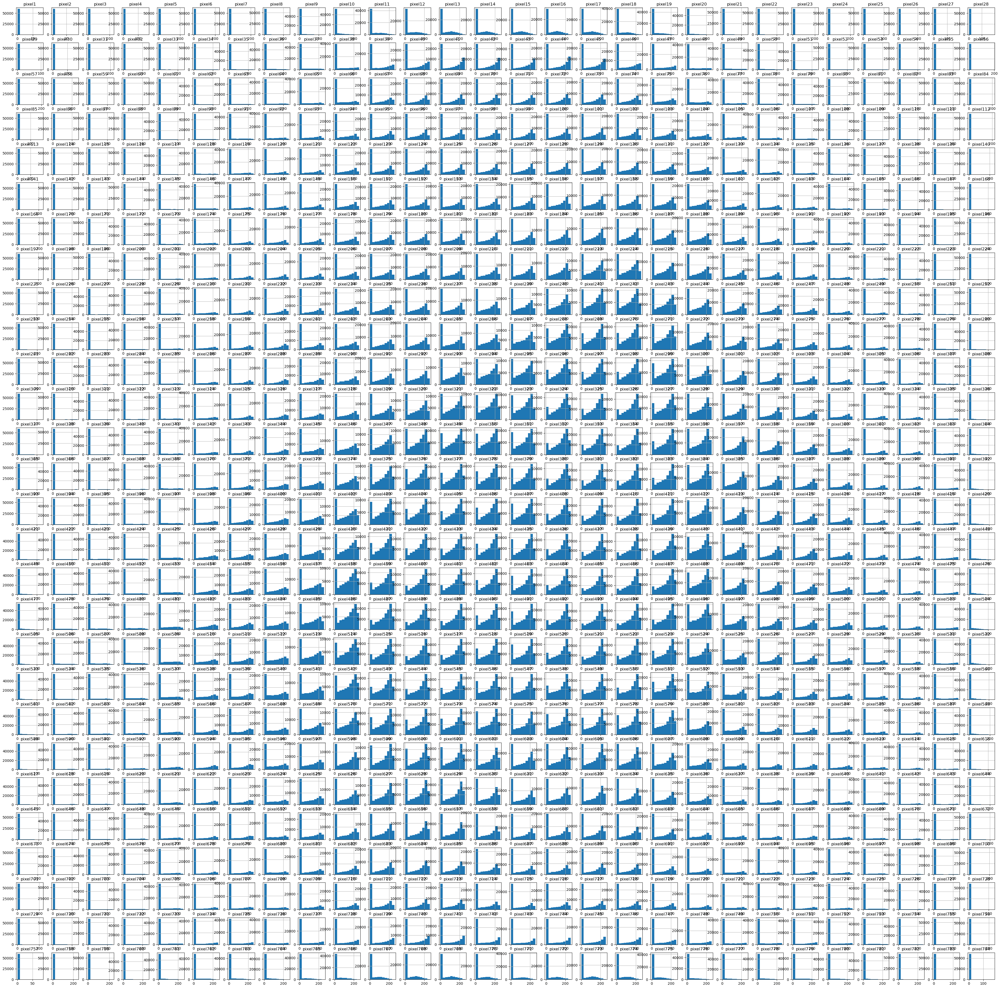

In [ ]:
plt.rcParams["figure.figsize"] = (50,50) # Custom figure size in inches
train_df.iloc[:,1:].hist()

# Helper Function

In [ ]:
class preprocessing:


    def __init__(self, dataframe):
        self.dataframe = dataframe


    #------------------------------- Check null ^_^ ------------------------------------
    '''
    This function counts null in each column in the dataframe and calculate the percent of nulls in the column then return the
    dataframe consist of 2 columns :  one contains count of null values in each column and second contains percent
    '''
    def null_values(self):
        null_val = pd.DataFrame(self.dataframe.isnull().sum())
        null_val.columns = ['null_val']
        null_val['percent_'] = round(null_val['null_val'] / len(self.dataframe.index), 2) * 100
        null_val = null_val.sort_values('percent_', ascending = False)
        return null_val
    #------------------------------- Check duplication ^_^  ------------------------------------
    '''
    This function counts duplicated rows in the dataframe
    '''
    def duplicated_values(self):
        return print("Number of duplicated rows" , self.dataframe.duplicated().sum())

    #------------------------------- CHECK CONSTANT FEATURES ^_^  ------------------------------------
    '''
    This function returns the columns that contain one value a cross all samples
    '''
    def constant_columns(self):
        constant_columns = [[col ,self.dataframe[col].value_counts()] for col in self.dataframe.columns if (self.dataframe[col].nunique()) == 1]
        return constant_columns

    #-------------------------------- Check the redundant_features ----------------------------------
    '''
    This Function check if there is a high correlation between 2 features .we set a thershold to 0.98. if any 2 features
    have a correlation larger than 0.95, put them in list .then return correlation matrix and list


    '''
    def redundant_features(self):
        #Creating the Correlation matrix
        cor_matrix = self.dataframe.corr().abs()
        #Select the upper triangular
        upper_tri =  pd.DataFrame(cor_matrix.where(np.triu(np.ones(cor_matrix.shape),k=1).astype(bool)))
        #Select the columns which are having absolute correlation greater than 0.98 and making a list of those columns
        features_high_corr = [column for column in upper_tri.columns if any(upper_tri[column] > 0.98)]
        if len(features_high_corr) == 0 :
            print("There is no redundant features")
            print("*" * 50)
            features_high_corr = "empty"
            return features_high_corr , upper_tri
        else:
            return features_high_corr, upper_tri

    #--------------------------------------- cardinality ^_^ ---------------------------------------
    '''
    calculate unique values in each column and returns dataframe consists of count and percent. This helps us to find column that have
    high cardinality
    '''
    def cardinality(self):
        unique_val = pd.DataFrame(np.array([len(self.dataframe[col].unique()) for col in self.dataframe.columns ]) , index=self.dataframe.columns)
        unique_val.columns = ['unique_val']
        unique_val['percent_'] = round(unique_val['unique_val'] / len(self.dataframe.index), 2) * 100
        unique_val = unique_val.sort_values('percent_', ascending = False)
        return unique_val


     #--------------------------------------- list of columns that will be dropped , filled and values that fill null  ^_^ ---------------------------------------
    '''
    This function determines the columns that are highly correlated (corr >  95%) and
    columns that have cardinality more than or equal 99 % and combine them in list called to_drop(columns that we will drop).
    To do that, we call the previous functions
    '''
    def columns_to_drop(self):
        features_high_corr,df_corr = self.redundant_features()
        car_features = self.cardinality()
        car_features_col = car_features[car_features['percent_'] >= 99].index
        to_drop = list(set(car_features_col) | set(features_high_corr))
        return to_drop


     #--------------------------------------- drop columns  ^_^ ---------------------------------------
    '''
    This function drop columns we specified.we will use it to drop columns that we determined from columns_to_drop function
    '''

    def drop_col(self):
        self.dataframe = self.dataframe.drop_duplicates()
        return self.dataframe





In [ ]:
preprocess_steps_train = preprocessing(train_df)

In [ ]:
preprocess_steps_test = preprocessing(test_df)


# Explore Data
----
------------------

### Check nulls
-------------------
------------------------

In [ ]:
preprocess_steps_train.null_values()

,null_val,percent_
label,0,0.0
pixel516,0,0.0
pixel518,0,0.0
pixel519,0,0.0
pixel520,0,0.0
...,...,...
pixel264,0,0.0
pixel265,0,0.0
pixel266,0,0.0
pixel267,0,0.0


**Observation**


Thanks to Allah, There is no null values in our data

### Check Duplication
----------------
----------------------

In [ ]:
preprocess_steps_train.duplicated_values()

Number of duplicated rows 43


**Observation**


- There are about 43 duplicated rows in our data. we will drop them later

### Check Constant Features
----------------
----------------------

In [ ]:
preprocess_steps_train.constant_columns()

[]

**Observation**


Thanks to Allah, There is no constant features in our data

### Check Redundant Features
----------------
----------------

In [ ]:
features_high_corr , upper_tri = preprocess_steps_train.redundant_features()
upper_tri

There is no redundant features
**************************************************


label    pixel1    pixel2    pixel3    pixel4    pixel5    pixel6  \
label       NaN  0.000674  0.002944  0.010439  0.007111  0.004632  0.011045   
pixel1      NaN       NaN  0.297899  0.067550  0.046608  0.026630  0.026172   
pixel2      NaN       NaN       NaN  0.575029  0.138710  0.054354  0.033185   
pixel3      NaN       NaN       NaN       NaN  0.387466  0.118135  0.087300   
pixel4      NaN       NaN       NaN       NaN       NaN  0.573172  0.325684   
pixel5      NaN       NaN       NaN       NaN       NaN       NaN  0.692891   
pixel6      NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel7      NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel8      NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel9      NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel10     NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel11     NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel12     NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel13     NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel14     NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel15     NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel16     NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel17     NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel18     NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel19     NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel20     NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel21     NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel22     NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel23     NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel24     NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel25     NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel26     NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel27     NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel28     NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel29     NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel30     NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel31     NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel32     NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel33     NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel34     NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel35     NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel36     NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel37     NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel38     NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel39     NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel40     NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel41     NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel42     NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel43     NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel44     NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel45     NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel46     NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel47     NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel48     NaN       NaN       NaN       NaN       NaN       NaN       NaN   
pixel49     NaN       NaN       NaN       NaN       NaN     

In [ ]:
import seaborn as sns

fig = plt.figure(figsize=(36,36), dpi = 480)
sns.heatmap(train_df.iloc[:,:50].corr(), annot = True, fmt = '.2f')

<AxesSubplot:>

**Observation**


As you can see, There are no columns are highly correlated.

### Check Cardinality
---------------------
-------------------

In [ ]:
preprocess_steps_train.cardinality()

,unique_val,percent_
label,10,0.0
pixel516,256,0.0
pixel518,256,0.0
pixel519,256,0.0
pixel520,256,0.0
...,...,...
pixel264,256,0.0
pixel265,256,0.0
pixel266,256,0.0
pixel267,256,0.0


**Observation**


As you can see, There are no columns are highly cardinality .

### Check Imbalance in classes
-------------------
-----------------------

[0 1 2 3 4 5 6 7 8 9]

10


<AxesSubplot:xlabel='label', ylabel='count'>

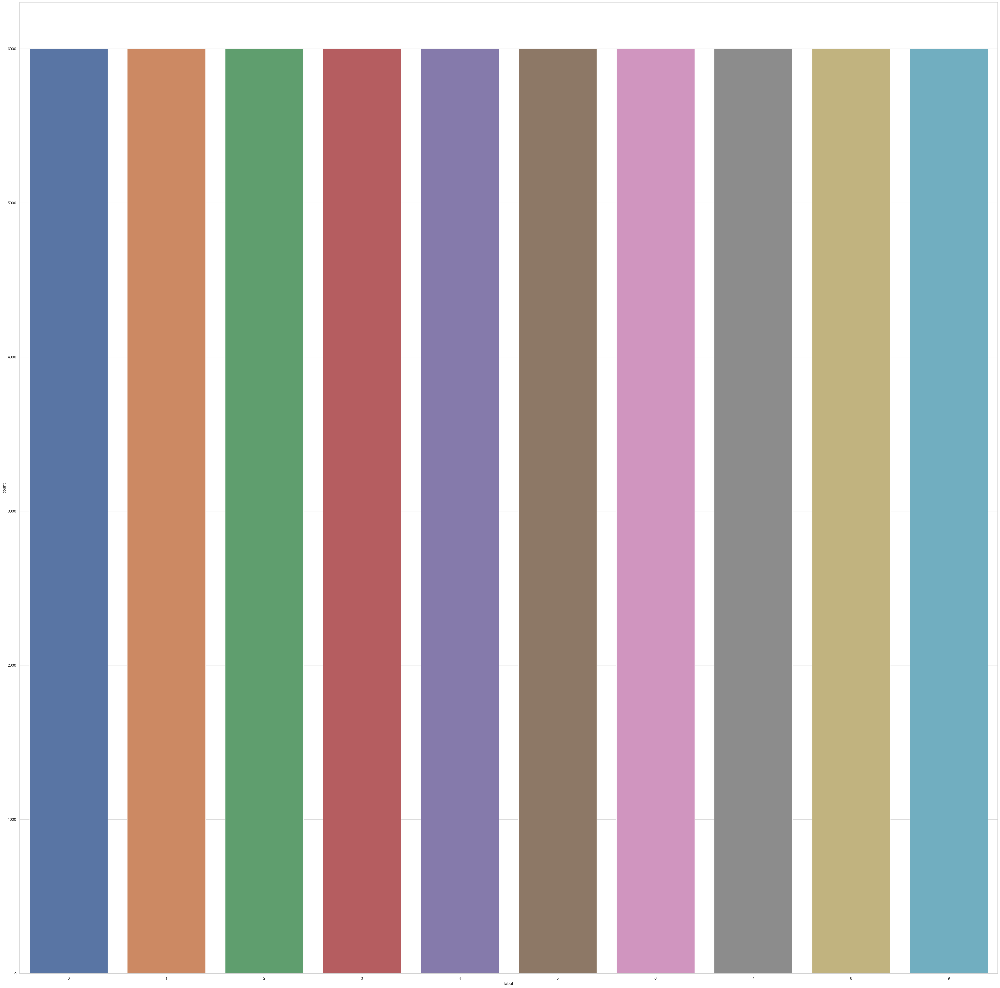

In [ ]:
classes ,count =  np.unique(train_df["label"],return_counts=True)
print("Classes are " ,classes)
print("Number of classes that we have " ,len(count))
print("count of each class " ,count)

sns.set_theme(style="whitegrid")
sns.countplot(data=train_df, x="label")

<AxesSubplot:>

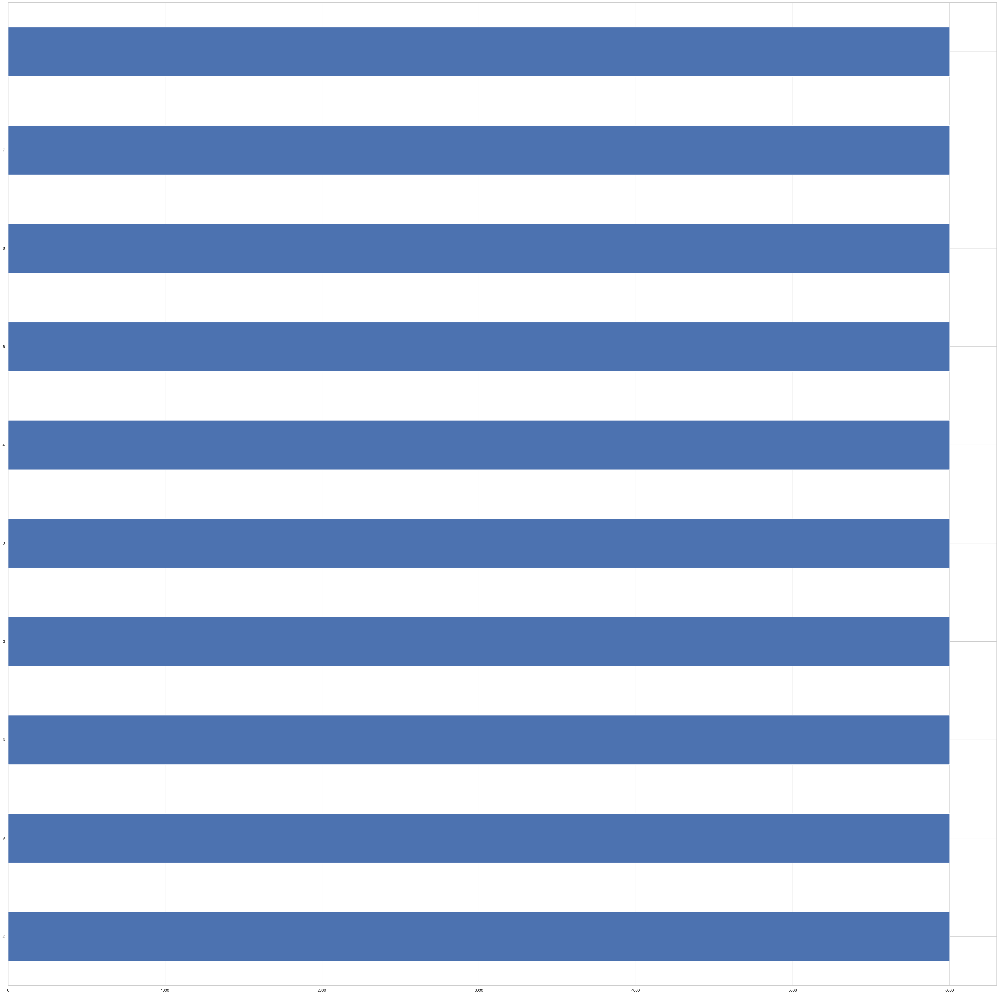

In [ ]:
train_df["label"].value_counts().plot(kind='barh')

**Observation**


As you can see, There are about 10 classes. all are balanced.

# Preprocessing Step
--------------------------
--------------------------

 - ##  drop

In [ ]:
train_df = preprocess_steps_train.drop_col()
preprocess_steps_train.duplicated_values()

Number of duplicated rows 0


 - ## convert dataframe into numpy array of float32

In [ ]:
#  we need to convert the dataframes into numpy arrays of float32 type which is the acceptable form for tensorflow and keras.
train_data = np.array(train_df, dtype = 'float32')
test_data = np.array(test_df, dtype = 'float32')

 - ## Reshape Data into the acceptable form of Lenet-50 model

Convert data from columns form to image matrix 28×28 form then add padding to be 32×32 because it is the minimum acceptable image size for Lenet-50 model.


In [ ]:
# reshape to 28×28
x_train = train_data[:,1:].reshape(-1, 28, 28)
x_test = test_data[:,1:].reshape(-1, 28, 28)
y_train = train_data[:,0]
y_test = test_data[:,0]

#pad image to change the size of images to 32 x 32
x_train = tf.pad(x_train, [[0, 0], [2,2], [2,2]])
x_test = tf.pad(x_test, [[0, 0], [2,2], [2,2]])


print("shape of train_data " , x_train.shape)
# Normalize data
x_train = x_train/255
x_test = x_test/255

# add the channels dimention so it will become (..., 32, 32, 1) instead of (..., 32, 32)
x_train = tf.expand_dims(x_train, axis=3, name=None)
x_test = tf.expand_dims(x_test, axis=3, name=None)

print("shape of train_data " , x_train.shape)


shape of train_data  (59957, 32, 32)
shape of train_data  (59957, 32, 32, 1)


 - ## Reshape Data into acceptable form of pretrained models( VGG16 and Resnet152V2)

In [ ]:
# Convert the images into 3 channels
train_X=np.dstack([train_data[:,1:]] * 3)
test_X=np.dstack([test_data[:,1:]]*3)

# reshape to 28×28
train_X = train_X.reshape(-1, 28, 28,3)

test_X = test_X.reshape(-1, 28, 28,3)


# Resize the images 48*48 as required by VGG16 & Resnet152V2

train_X = np.asarray([img_to_array(array_to_img(im, scale=False).resize((48,48))) for im in train_X])
test_X = np.asarray([img_to_array(array_to_img(im, scale=False).resize((48,48))) for im in test_X])


print("shape of train_data " , train_X.shape)
# Normalize data
train_X = train_X/255
test_X = test_X/255



print("shape of train_data " , train_X.shape)



shape of train_data  (59957, 48, 48, 3)
shape of train_data  (59957, 48, 48, 3)


- ## Encode the labels


---



---




In [ ]:
Encode = OneHotEncoder()
onehot_encoding = Encode.fit(y_train.reshape(-1, 1))
y_train = onehot_encoding.transform(y_train.reshape(-1, 1))
y_test = onehot_encoding.transform(y_test.reshape(-1, 1))
print("classes after applying one encoding" , y_train.toarray())

classes after applying one encoding [[0. 0. 1. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 1.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 1. 0. 0.]]


# Visualize - Draw Images
-----------------
---------------------


<Figure size 640x480 with 0 Axes>

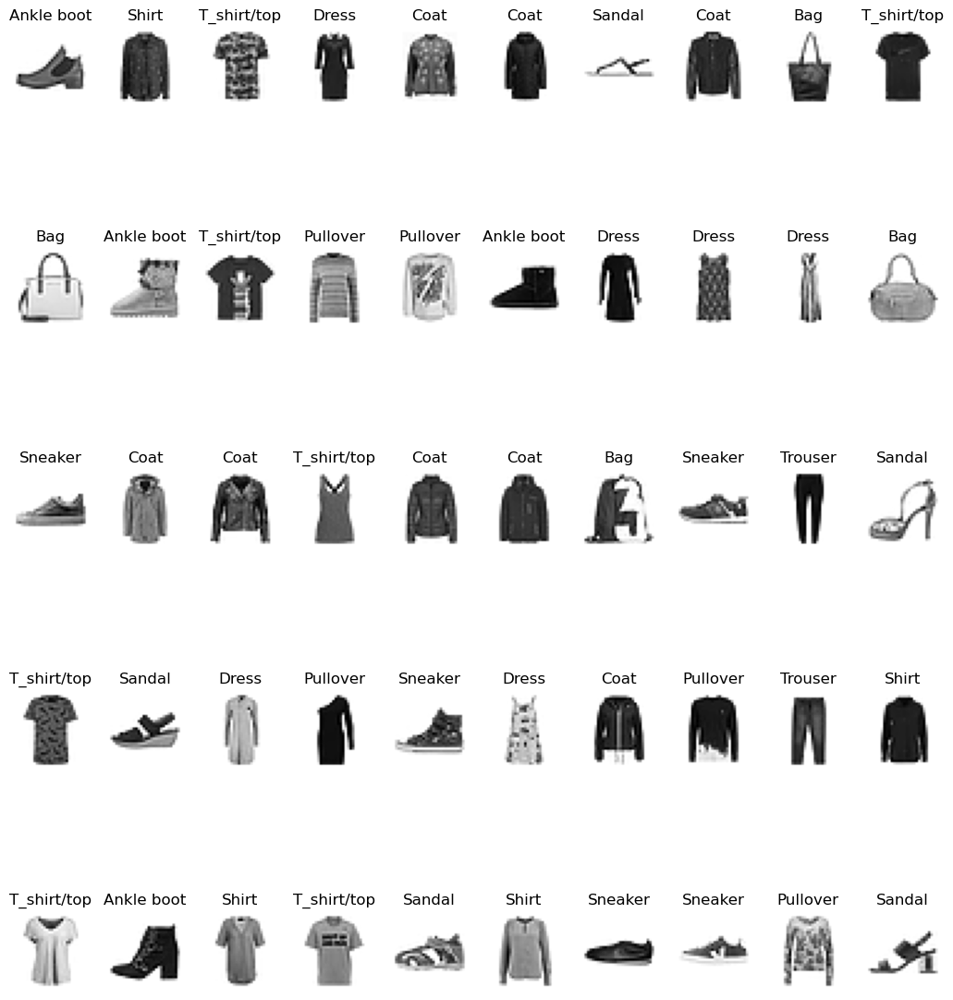

In [ ]:
ROW_IMG = 10
N_ROWS = 5
fig = plt.figure()
plt.figure(figsize=(13,15))
labels = ['T_shirt/top', 'Trouser', 'Pullover', 'Dress', 'Coat', 'Sandal', 'Shirt', 'Sneaker', 'Bag', 'Ankle boot']
for index in range(1, ROW_IMG * N_ROWS + 1):
    plt.subplot(N_ROWS, ROW_IMG, index)
    plt.axis('off')
    plt.imshow(x_train[index], cmap='binary')
    plt.title(labels[int(y_train[index])])

#Helper Function
-------
-----------------

In [ ]:
class MyHyperModel(kt.HyperModel):
    def build(self, hp):
      model = models.Sequential()
      model.add(layers.Conv2D(6, 5, activation='tanh', input_shape=x_train.shape[1:]))
      model.add(layers.AveragePooling2D(2))
      model.add(layers.Activation('sigmoid'))
      model.add(layers.Conv2D(16, 5, activation='tanh'))
      model.add(layers.AveragePooling2D(2))
      model.add(layers.Activation('sigmoid'))
      model.add(layers.Conv2D(120, 5, activation='tanh'))
      model.add(layers.Flatten())
      model.add(layers.Dense(84, activation='tanh'))
      model.add(layers.Dense(10, activation='softmax'))
      model.summary()


      # Tune learning rate for Adam optimizer with values from 0.01, 0.001, or 0.0001
      hp_learning_rate = hp.Choice("learning_rate", values=[1.0 ,1e-2, 1e-3, 1e-4])

      # Define optimizer, loss, and metrics
      model.compile(optimizer= tf.keras.optimizers.Adam(learning_rate=hp_learning_rate),
                    loss=tf.keras.losses.CategoricalCrossentropy(),
                    metrics=["accuracy"])

      return model

    def fit(self, hp, model, *args, **kwargs):
        return model.fit(
            *args,
            batch_size= hp.Choice("batch_size", [256, 32 , 64 , 128]),
            epochs = hp.Choice('epochs', values=[100,200 , 120 ,50 , 400,70,20]),
            **kwargs
        )





def tune_model(no_trails , xtrain, ytrain):
    tuner = kt.RandomSearch(
        MyHyperModel(),
        objective="val_accuracy",
        max_trials=no_trails,
        overwrite=True,
        directory="my_dir",
        project_name="tune_hypermodel",)
    # Run the hyperparameter search. The arguments for the search method are the same as those used for tf.keras.model.fit in addition to the callback above.

    tuner.search(xtrain, ytrain.toarray(),  validation_split=0.2, callbacks=[stop_early ,csv_logger , tf.keras.callbacks.TensorBoard("/tmp/tb_logs")] )
    # Get the optimal hyperparameters
    best_hps=tuner.get_best_hyperparameters(num_trials=1)[0]

    print(f"""
    The hyperparameter search is complete. The optimal number of units in the first densely-connected
    layer is and the optimal learning rate for the optimizer
    is {best_hps.get('learning_rate')}.
     """)
    return tuner , best_hps

def train_best_model(best_hyp ,xtrain , ytrain , xtest ,ytest , cross_validation = False ):
    model = tuner.hypermodel.build(best_hyp)
    epochs_ = best_hps.get('epochs')
    batch_size_ = best_hps.get('batch_size')
    if cross_validation :
        # Create StratifiedKFold object.
        kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=seed)
        lst_accu_stratified = []
        history_fold = []
        for train_index, test_index in kfold.split(xtrain , np.argmax(ytrain.toarray() , axis = 1)):
            print("Start Fold............")
            x_train_fold, x_test_fold = tf.gather_nd(xtrain,indices=train_index.reshape(-1,1)), tf.gather_nd(xtrain,indices=test_index.reshape(-1,1))
            y_train_fold, y_test_fold = ytrain[train_index], ytrain[test_index]
            history = model.fit(x_train_fold,y_train_fold.toarray(),epochs = epochs_ , batch_size = batch_size_ ,
                                validation_data=(x_test_fold ,y_test_fold.toarray()), callbacks=[stop_early ,csv_logger , tf.keras.callbacks.TensorBoard("/tmp/tb_logs")])
            accuracy , report = evaluate_model(xtest, ytest , model)
            lst_accu_stratified.append(accuracy)
            history_fold.append(history)
            print("End Fold............")

        # Print the output.
        print('List of possible accuracy:', lst_accu_stratified)
        print('\nMaximum Accuracy That can be obtained from this model is:',
              max(lst_accu_stratified)*100, '%')
        print('\nMinimum Accuracy:',
              min(lst_accu_stratified)*100, '%')
        print('\nOverall Accuracy:',
            statistics.mean(lst_accu_stratified)*100, '%')


        return  statistics.mean(lst_accu_stratified) ,history_fold

    else:

        history = model.fit(xtrain, ytrain.toarray(), epochs = epochs_ , batch_size = batch_size_, validation_split=0.2,verbose=5, callbacks=[stop_early ,csv_logger , tf.keras.callbacks.TensorBoard("/tmp/tb_logs")])

        return model , history

def plot_training_curve(history_model , kfold):

    for i in range(kfold):
        if kfold == 1 :
            history = history_model
        else :
            print("kfold {}".format(kfold))
            history = history_model[i]
        plt.figure(figsize=(10, 15))
        plt.plot(history.history['accuracy'])
        plt.plot(history.history['val_accuracy'])
        plt.title('model accuracy')
        plt.ylabel('accuracy')
        plt.xlabel('epoch')
        plt.legend(['train', 'val'], loc='upper left')
        plt.show()

        print("_______"*50)
        plt.figure(figsize=(10, 15))
        plt.plot(history.history['loss'])
        plt.plot(history.history['val_loss'])
        plt.title('model loss')
        plt.ylabel('loss')
        plt.xlabel('epoch')
        plt.legend(['train', 'val'], loc='upper left')
        plt.show()

def evaluate_model(xtest, ytest , model):
    y_pred =  model.predict(xtest)
    report = classification_report (np.argmax(ytest.toarray() , axis = 1) ,np.argmax(y_pred , axis = 1) )
    print("classification report")
    print(report)
    print("_______"*50)
    accuracy = accuracy_score( np.argmax(ytest.toarray() , axis = 1) ,np.argmax(y_pred , axis = 1) )
    print("test accuracy" , accuracy)
    print("_______"*50)

    return accuracy , report

def preTrainedVgg16(input_layer):
    preTrainedModelVgg16 = VGG16(input_tensor = input_layer, include_top = False, weights='imagenet')
    VGG16layers=preTrainedModelVgg16.layers
    print("Number of layer Vgg16 : ",len(VGG16layers))
    for layer  in range(len(VGG16layers)-5):
           VGG16layers[layer].trainable = False

    preTrainedModelVgg16.summary()
    #Vgg16 Model
    x=Flatten()(preTrainedModelVgg16.output)
    #Fully Connection Layer
    # FC1
    x=Dense(1024, activation="relu")(x)
    # FC2
    x=Dense(1024, activation="relu")(x)
    # FC3
    x=Dense(1024, activation="relu")(x)
    #Dropout to avoid overfitting effect
    x=Dropout(0.5)(x)
    # FC4
    x=Dense(512, activation="relu")(x)
    # FC5
    x=Dense(512, activation="relu")(x)
    #Dropout to avoid overfitting effect
    x=Dropout(0.4)(x)
    # FC6
    x=Dense(256, activation="relu")(x)
    # FC7
    x=Dense(64, activation="relu")(x)
    # FC8
    x=Dense(64, activation="relu")(x)
    #Dropout to avoid overfitting effect
    x=Dropout(0.2)(x)
    #output layer
    x=Dense(10,activation="softmax")(x)

    modelpreTrainedModelVgg16=models.Model(inputs=input_layer,outputs=x)
    return modelpreTrainedModelVgg16



@jit(target_backend='cuda')
def fit_pretrained_model(xtrain , ytrain , model , epoch):
    model.compile(loss='categorical_crossentropy', optimizer='adam',metrics=['accuracy'])
    history = model.fit(xtrain,ytrain , epochs=epoch, batch_size=128,  validation_split=0.2)
    return history , model

from numba import jit, cuda
@jit(target_backend='cuda')
def preTrainedResNet152V2 (input_layer):
    preTrainedModelResNet152V2  = ResNet152V2 (input_tensor = input_layer, include_top = False, weights="imagenet")
    ResNet152V2layers=preTrainedModelResNet152V2.layers
    print("Number of layer ResNet152V2 : ",len(ResNet152V2layers))
    for layer  in range(len(ResNet152V2layers)-64):
        ResNet152V2layers[layer].trainable = False

    preTrainedModelResNet152V2.summary()
    #ResNet152V2 Model
    x=Flatten()(preTrainedModelResNet152V2.output)

    #Fully Connection Layers
    # FC1
    x=Dense(1024, activation="relu")(x)
    # FC2
    x=Dense(1024, activation="relu")(x)
    # FC3
    x=Dense(1024, activation="relu")(x)
    # FC4
    x=Dense(1024, activation="relu")(x)
    # #Dropout to avoid overfitting effect
    x=Dropout(0.2)(x)
    # FC5
    x=Dense(512, activation="relu")(x)
    # FC6
    x=Dense(512, activation="relu")(x)
    # FC7
    x=Dense(256, activation="relu")(x)
    # FC8
    x=Dense(256, activation="relu")(x)
    # #Dropout to avoid overfitting effect
    x=Dropout(0.2)(x)
    #output layer
    x=Dense(10,activation="softmax")(x)
    #concatenation layers
    modelResNet152V2=models.Model(inputs=input_layer,outputs=x)
    modelResNet152V2.summary()
    return modelResNet152V2






# Tune hyperparameters
-------
-----------------

In [ ]:
stop_early = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5)
csv_logger = tf.keras.callbacks.CSVLogger('training_tune.csv', append=True)
tuner , best_hps = tune_model(100 ,x_train , y_train)

Trial 100 Complete [00h 19m 59s]

val_accuracy: 0.8727484941482544



Best val_accuracy So Far: 0.8895930647850037

Total elapsed time: 07h 29m 46s

INFO:tensorflow:Oracle triggered exit



    The hyperparameter search is complete. The optimal number of units in the first densely-connected

    layer is and the optimal learning rate for the optimizer

    is 0.001.

     


In [ ]:
print("Best hyperparameters(" ,"lr :", best_hps.get('learning_rate') ,"epoch :" ,best_hps.get('epochs') ,"batch size :" ,best_hps.get('batch_size'),')')

Best hyperparameters( lr : 0.001 epoch : 120 batch size : 128 )


In [ ]:
!pip install -U tensorboard

In [ ]:

%load_ext tensorboard


%tensorboard --logdir /tmp/tb_logs

The tensorboard extension is already loaded. To reload it, use:

  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 12316), started 8:02:01 ago. (Use '!kill 12316' to kill it.)

In [ ]:
!tensorboard dev upload --logdir logs \
    --name "(optional) My latest experiment" \
    --description "(optional) Simple comparison of several hyperparameters"

^C


# Train model with best hyperparameters

In [ ]:
csv_logger = tf.keras.callbacks.CSVLogger('training_best.csv', append=True)
model ,history_best_model = train_best_model(best_hps ,x_train , y_train  ,x_test, y_test  )

Model: "sequential_5"

_________________________________________________________________

 Layer (type)                Output Shape              Param #   


 conv2d_15 (Conv2D)          (None, 28, 28, 6)         156       

                                                                 

 average_pooling2d_10 (Avera  (None, 14, 14, 6)        0         

 gePooling2D)                                                    

                                                                 

 activation_10 (Activation)  (None, 14, 14, 6)         0         

                                                                 

 conv2d_16 (Conv2D)          (None, 10, 10, 16)        2416      

                                                                 

 average_pooling2d_11 (Avera  (None, 5, 5, 16)         0         

 gePooling2D)                                                    

                                                                 

 activation_11 (Activation)  (None, 5,

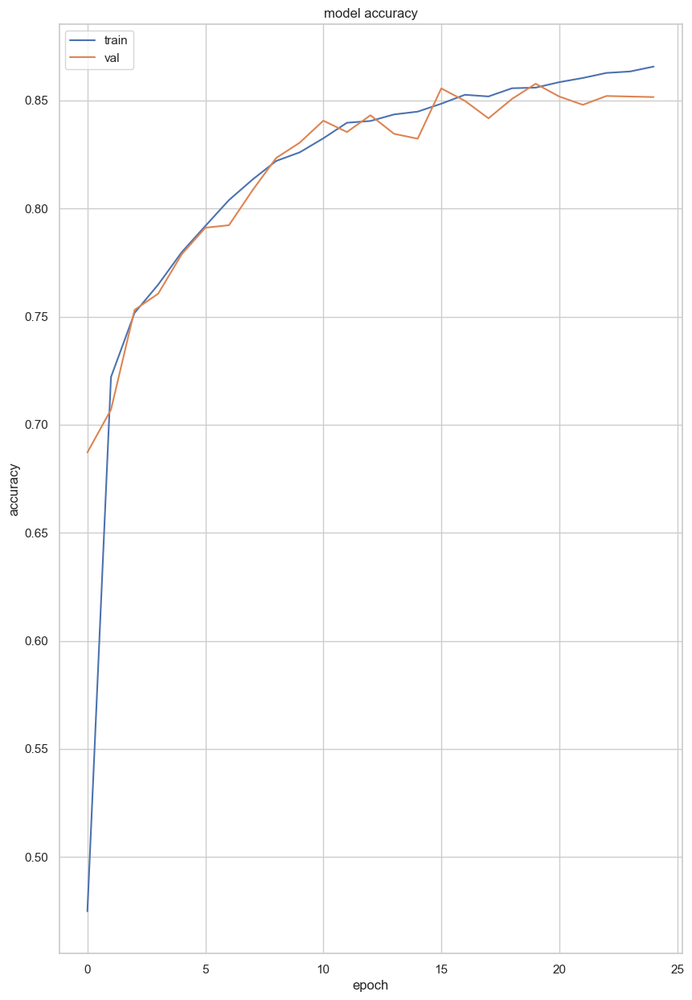

______________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________


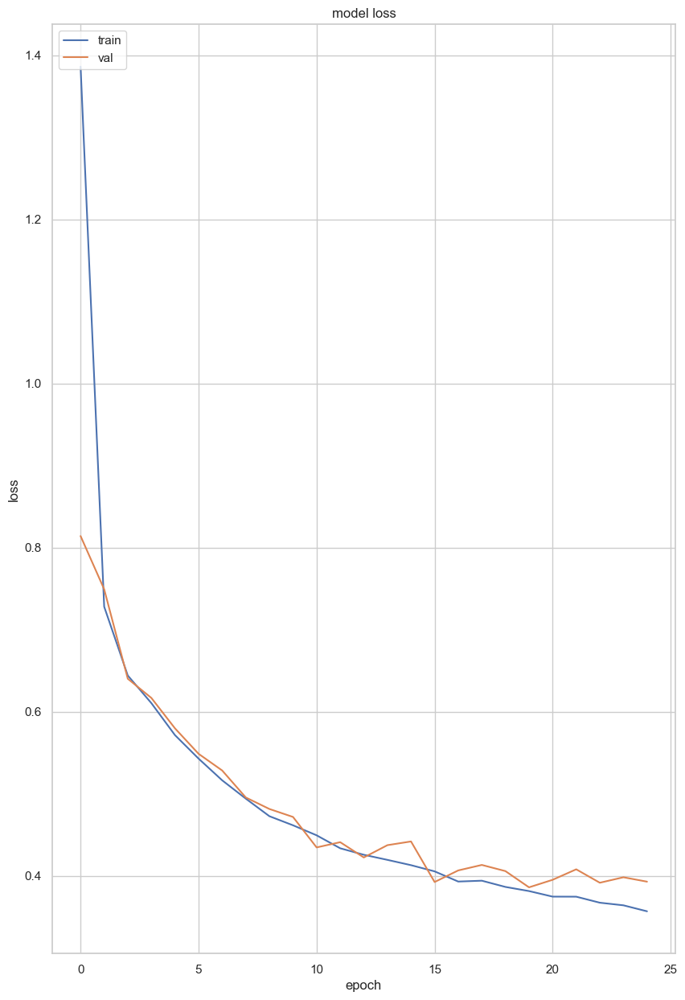

In [ ]:
plot_training_curve(history_best_model , 1)

In [ ]:
accuracy , report = evaluate_model(x_test, y_test , model)

313/313 [==============================] - 1s 2ms/step

classification report

              precision    recall  f1-score   support



           0       0.85      0.69      0.76      1000

           1       0.97      0.96      0.97      1000

           2       0.82      0.67      0.74      1000

           3       0.80      0.91      0.85      1000

           4       0.69      0.89      0.78      1000

           5       0.95      0.95      0.95      1000

           6       0.67      0.64      0.66      1000

           7       0.96      0.89      0.92      1000

           8       0.97      0.96      0.96      1000

           9       0.90      0.98      0.94      1000



    accuracy                           0.85     10000

   macro avg       0.86      0.85      0.85     10000

weighted avg       0.86      0.85      0.85     10000



_________________________________________________________________________________________________________________________________________________

# Cross validation

Model: "sequential_9"

_________________________________________________________________

 Layer (type)                Output Shape              Param #   


 conv2d_27 (Conv2D)          (None, 28, 28, 6)         156       

                                                                 

 average_pooling2d_18 (Avera  (None, 14, 14, 6)        0         

 gePooling2D)                                                    

                                                                 

 activation_18 (Activation)  (None, 14, 14, 6)         0         

                                                                 

 conv2d_28 (Conv2D)          (None, 10, 10, 16)        2416      

                                                                 

 average_pooling2d_19 (Avera  (None, 5, 5, 16)         0         

 gePooling2D)                                                    

                                                                 

 activation_19 (Activation)  (None, 5,

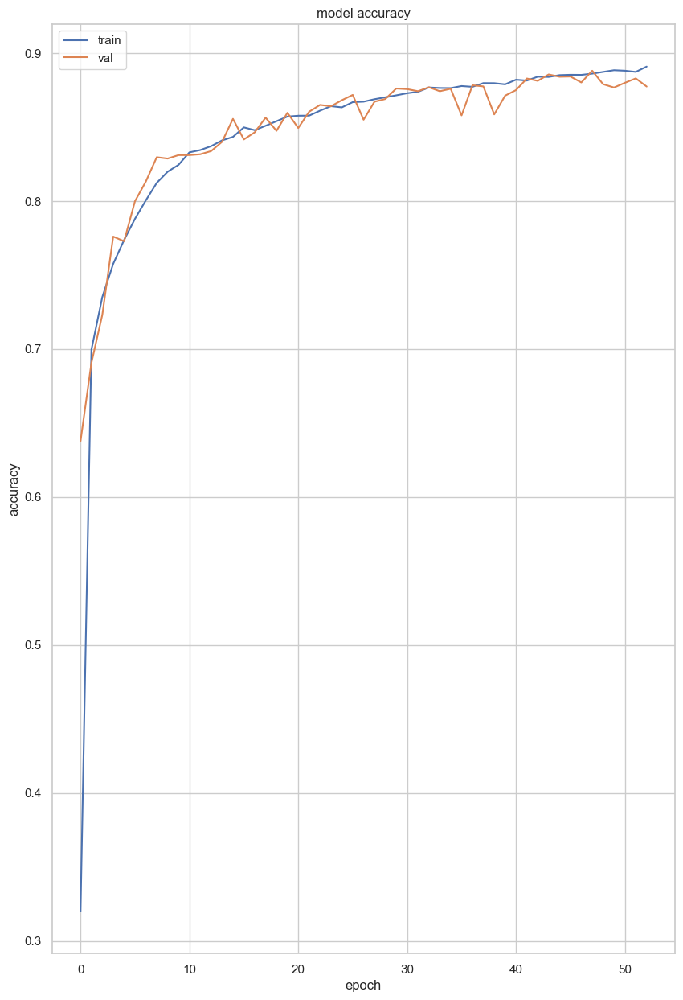

______________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________


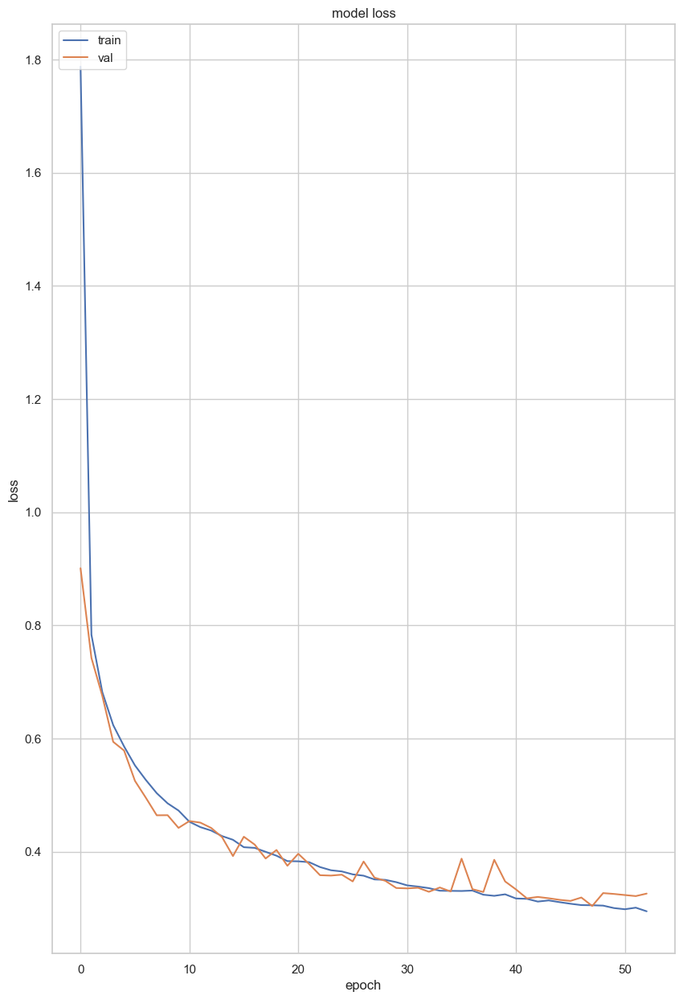

kfold 5


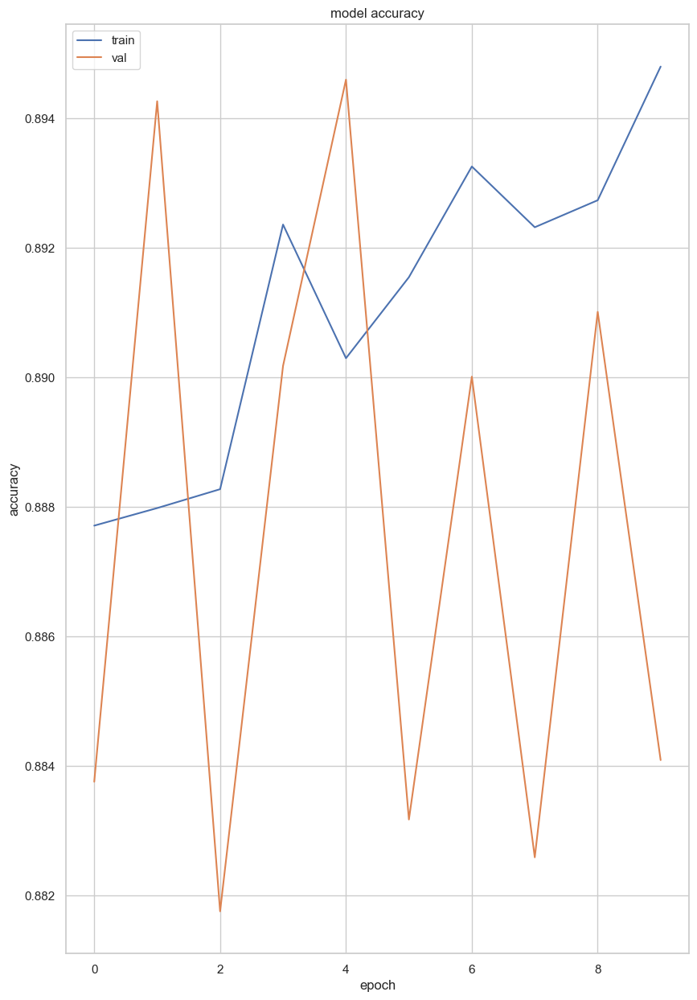

______________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________


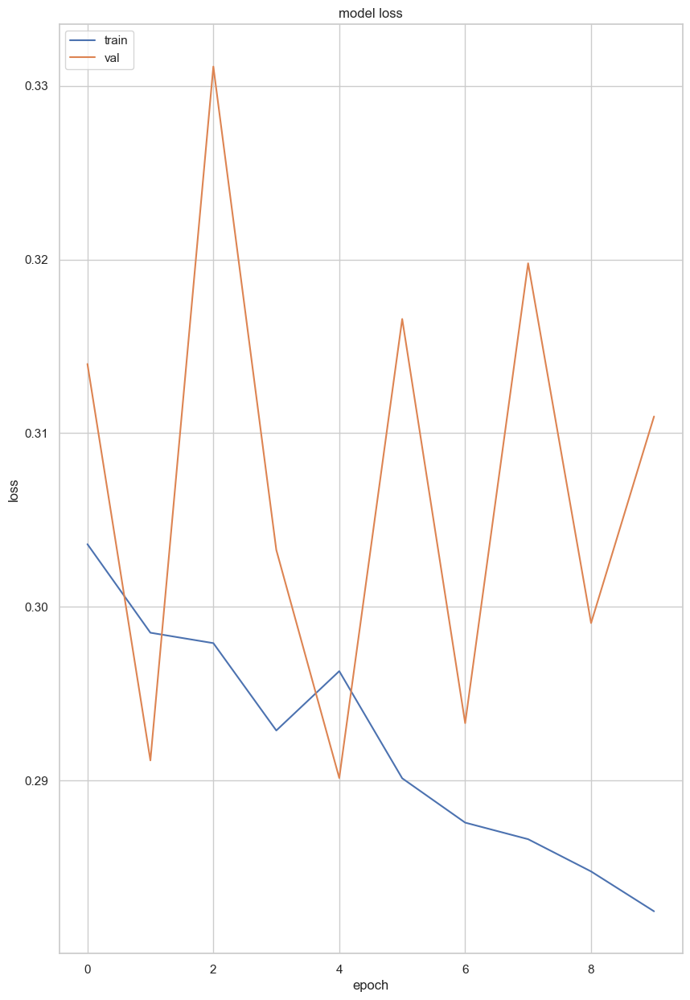

kfold 5


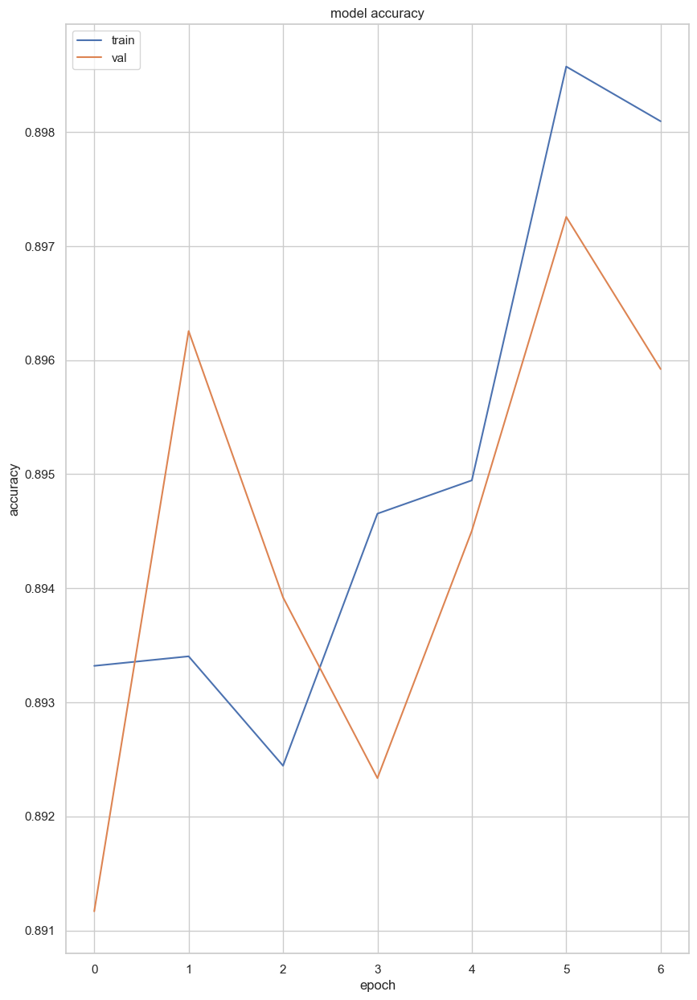

______________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________


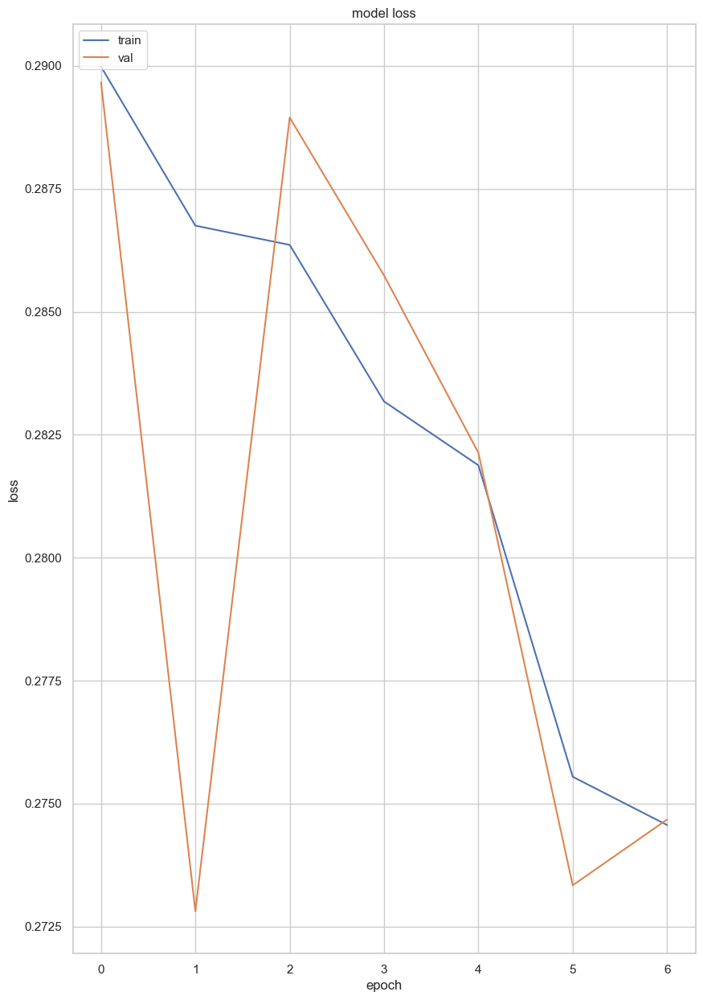

kfold 5


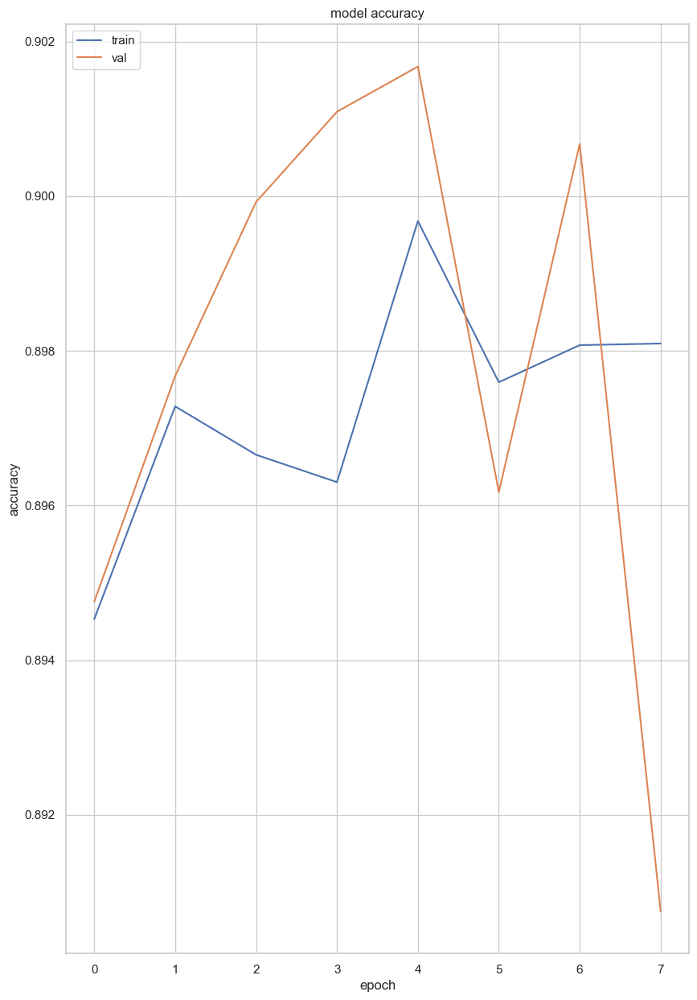

______________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________


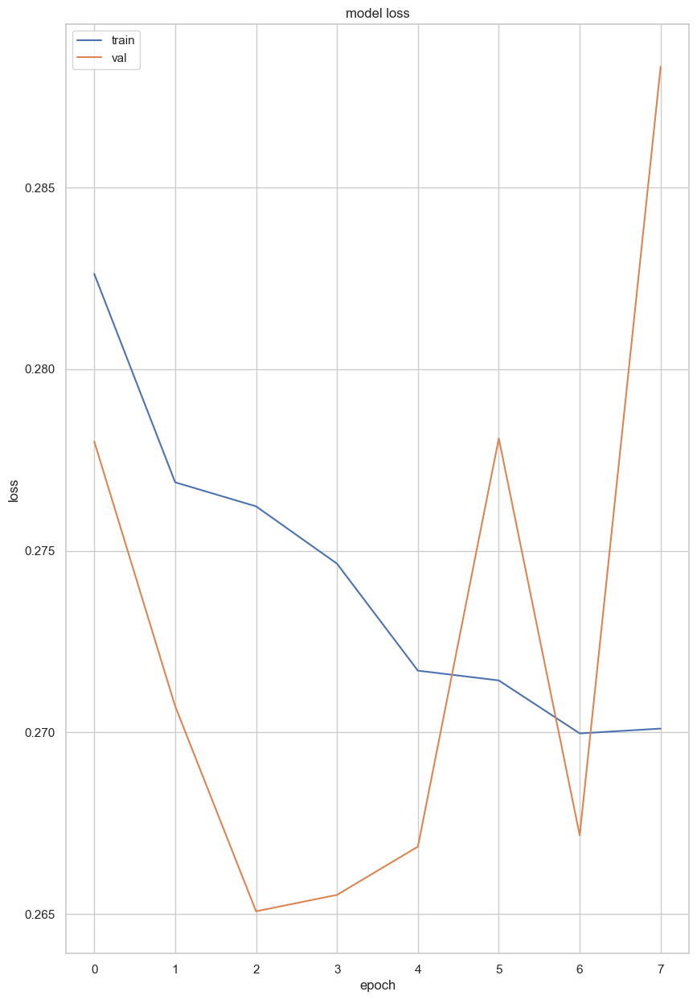

kfold 5


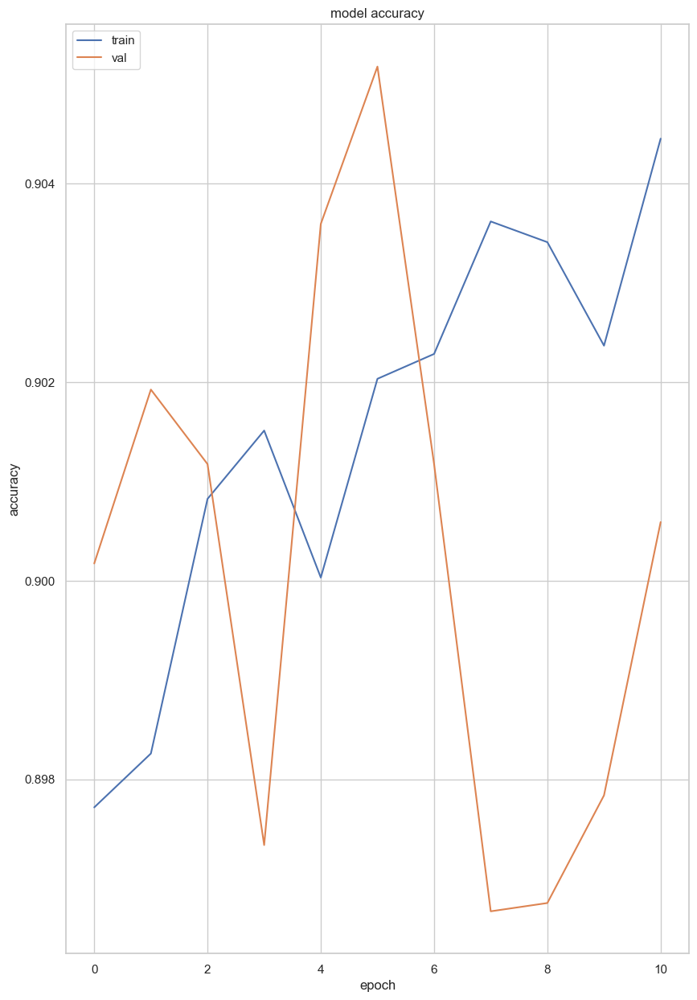

______________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________


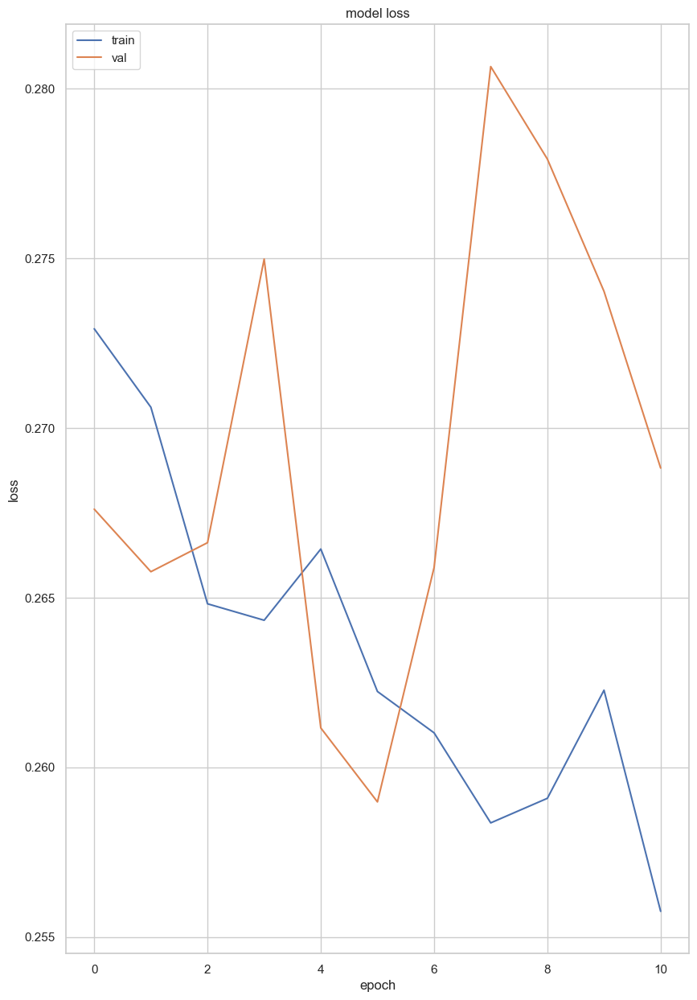

In [ ]:

seed= 123
csv_logger = tf.keras.callbacks.CSVLogger('training_cv.csv', append=True)
model_cv ,history_best_model_cv = train_best_model(best_hps ,x_train , y_train ,x_test, y_test ,cross_validation = True)
plot_training_curve(history_best_model_cv , 5)

# Transfer learning
--------------------
---------------------

In [ ]:
input_layer=layers.Input(shape=(48,48,3))

## VGG16
-------------
-------------------


58889256/58889256 [==============================] - 3s 0us/step

Number of layer Vgg16 :  19

Model: "vgg16"

_________________________________________________________________

 Layer (type)                Output Shape              Param #   


 input_1 (InputLayer)        [(None, 48, 48, 3)]       0         

                                                                 

 block1_conv1 (Conv2D)       (None, 48, 48, 64)        1792      

                                                                 

 block1_conv2 (Conv2D)       (None, 48, 48, 64)        36928     

                                                                 

 block1_pool (MaxPooling2D)  (None, 24, 24, 64)        0         

                                                                 

 block2_conv1 (Conv2D)       (None, 24, 24, 128)       73856     

                                                                 

 block2_conv2 (Conv2D)       (None, 24, 24, 128)       147584    

                

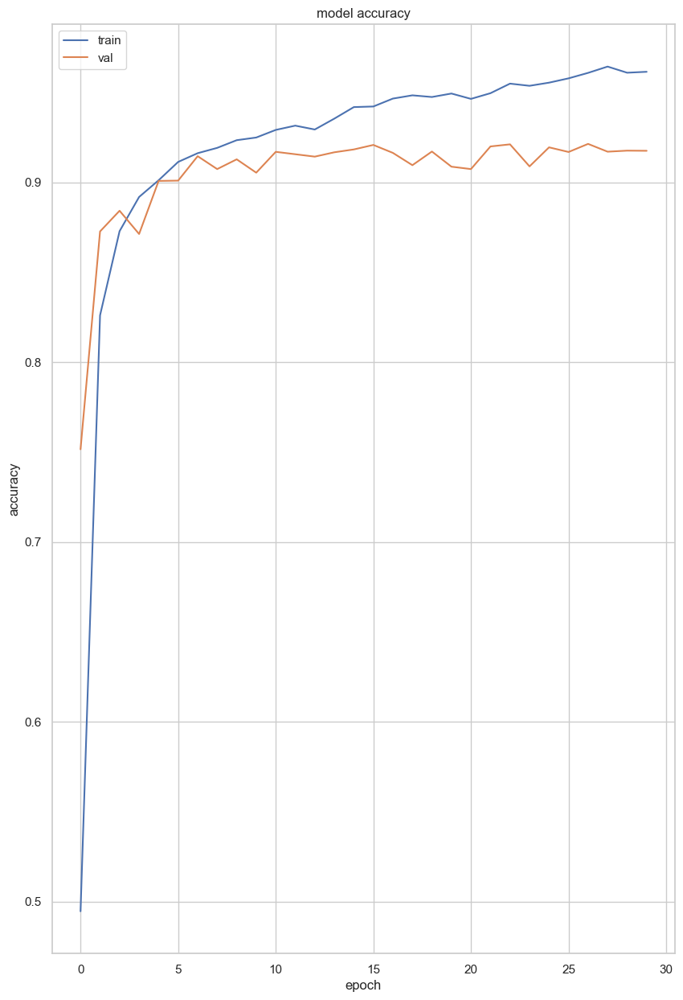

______________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________


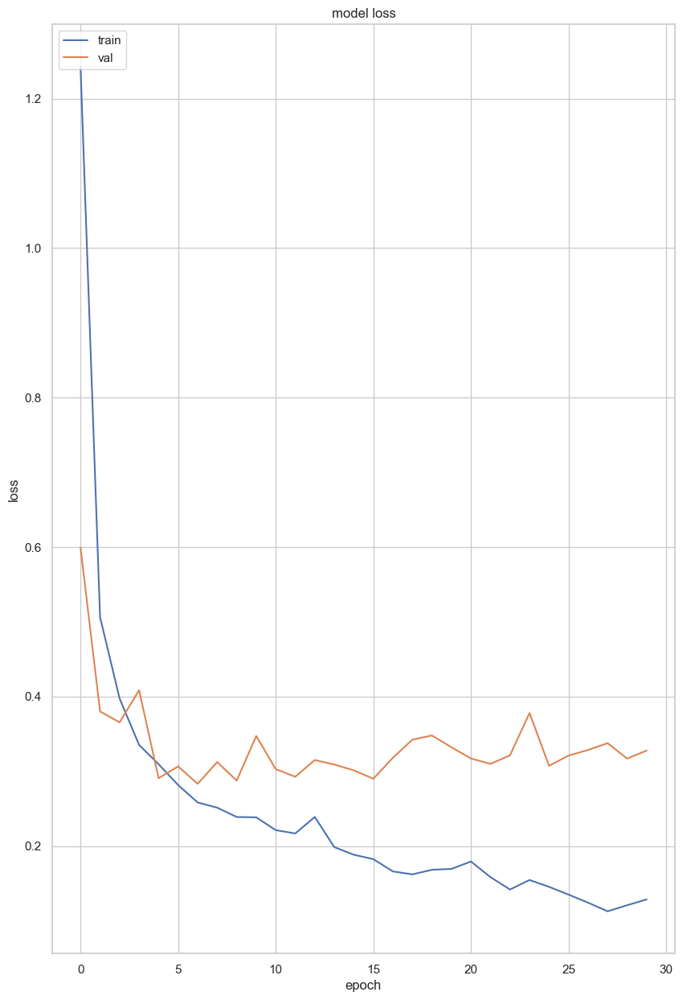

In [ ]:
vgg16_model = preTrainedVgg16(input_layer)
history_vgg16_model ,vgg16_model_ = fit_pretrained_model(train_X ,y_train.toarray(), vgg16_model, 30)
plot_training_curve(history_vgg16_model , 1)


In [ ]:

accuracy_vgg , report_vgg = evaluate_model(test_X, y_test , vgg16_model_)


313/313 [==============================] - 33s 107ms/step

classification report

              precision    recall  f1-score   support



           0       0.88      0.87      0.87      1000

           1       0.99      0.99      0.99      1000

           2       0.88      0.91      0.89      1000

           3       0.94      0.92      0.93      1000

           4       0.88      0.88      0.88      1000

           5       0.95      0.99      0.97      1000

           6       0.78      0.79      0.79      1000

           7       0.98      0.93      0.95      1000

           8       0.99      0.98      0.99      1000

           9       0.97      0.97      0.97      1000



    accuracy                           0.92     10000

   macro avg       0.92      0.92      0.92     10000

weighted avg       0.92      0.92      0.92     10000



______________________________________________________________________________________________________________________________________________

## ResNet152V2
-----------------------
--------------------

234545216/234545216 [==============================] - 7s 0us/step
Number of layer ResNet152V2 :  564
Model: "resnet152v2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 48, 48, 3)]  0           []                               
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 54, 54, 3)    0           ['input_1[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 24, 24, 64)   9472        ['conv1_pad[0][0]']              
                                                                                                  
 pool1_pad (ZeroPadding2D)      (None, 26, 26, 64)   0           ['conv1_conv[0][0]']

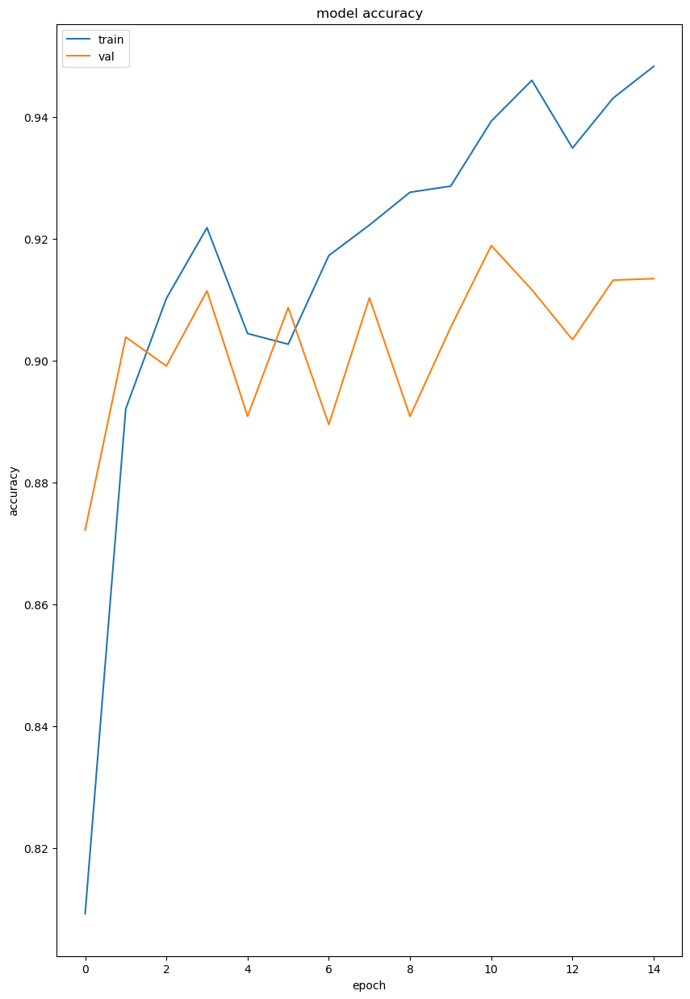

______________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________


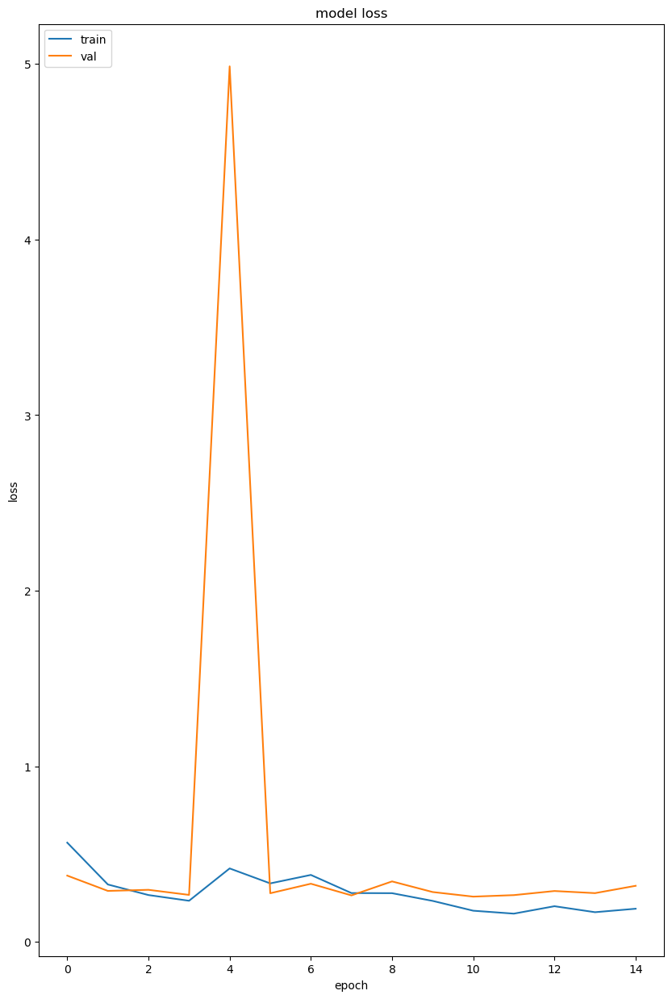

In [ ]:

ResNet152V2_model = preTrainedResNet152V2(input_layer)
history_ResNet152V2_model , ResNet152V2_model_ = fit_pretrained_model(train_X , y_train.toarray() , ResNet152V2_model,15)
plot_training_curve(history_ResNet152V2_model , 1)


In [ ]:
accuracy_resnet , report_resnet = evaluate_model(test_X, y_test , ResNet152V2_model_)

313/313 [==============================] - 14s 34ms/step
classification report
              precision    recall  f1-score   support

           0       0.84      0.88      0.86      1000
           1       0.99      0.98      0.99      1000
           2       0.91      0.85      0.88      1000
           3       0.91      0.93      0.92      1000
           4       0.88      0.85      0.87      1000
           5       0.98      0.96      0.97      1000
           6       0.75      0.80      0.77      1000
           7       0.94      0.97      0.95      1000
           8       0.99      0.98      0.99      1000
           9       0.98      0.96      0.97      1000

    accuracy                           0.92     10000
   macro avg       0.92      0.92      0.92     10000
weighted avg       0.92      0.92      0.92     10000

__________________________________________________________________________________________________________________________________________________________________